# Benchmark GMM Dorso

### Outline
* generate expression matrix - ground truth (atlas, see normal droso tutorial)
* generate expression matrix - normal reconstruction (see normal droso tutorial)
* generate expression matrix - GMM (see "cleaning demonstration) - maybe different modes

* calculate similarity values of the matrixes
* plot them

Infos:

"dge_rep" mode: None (there are different possibilities, maybe try other later)


<a class="anchor" id="imports"></a>

In [2]:
# install
# pip install novosparc
# imports
from importlib import reload

import anndata
%matplotlib inline

import importlib.util
import sys
spec = importlib.util.spec_from_file_location("novosparc", "/home/vfs/PycharmProjects/rajewskyLab/novosparc/novosparc/__init__.py")
novosparc = importlib.util.module_from_spec(spec)
sys.modules["novosparc"] = novosparc
spec.loader.exec_module(novosparc)

# import novosparc
import os
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.viridis()
# import altair as alt
from scipy.spatial.distance import cdist, squareform, pdist
from scipy.stats import ks_2samp
from scipy.stats import pearsonr
from scipy.stats import spearmanr
from scipy.stats import zscore
import sklearn

import random
random.seed(42)

# working directory
# os.chdir("/home/vfs/PycharmProjects/rajewskyLab/novosparc") # when I use this the notebook does not use the normal novosparc anymore - but when I put the notebooke physically in that directory everything works normally - where does this come from?

# test genes
pl_genes = ['sna', 'ken', 'eve','zen2','ImpE2']

# Reading expression data to scanpy AnnData (cells x genes)
data_dir = '../../novosparc/datasets/drosophila_scRNAseq/'
data_path = os.path.join(data_dir, 'dge_normalized.txt')
dataset = sc.read(data_path).T
gene_names = dataset.var.index.tolist()

num_cells, num_genes = dataset.shape # 1297 cells x 8924 genes

print('number of cells: %d' % num_cells)
print('number of genes: %d' % num_genes)
# optional: subset cells
num_cells = 1000
sc.pp.subsample(dataset, n_obs=num_cells)
# dge_rep mode
dge_rep = None # a representation of cells gene expression
# highly var genes
sc.pp.highly_variable_genes(dataset)
is_var_gene = dataset.var['highly_variable']
var_genes = list(is_var_gene.index[is_var_gene])

# atlas settings
atlas_dir = '../../novosparc/datasets/bdtnp/'
target_space_path = os.path.join(atlas_dir, 'geometry.txt')
locations = pd.read_csv(target_space_path, sep=' ')
num_locations = 3039 # coming from the spatial data
locations_apriori = locations[:num_locations][['xcoord', 'zcoord']].values

number of cells: 1297
number of genes: 8924


<Figure size 432x288 with 0 Axes>

In [2]:
## Expression Matrix - ground truth
locations = locations_apriori
atlas_path = os.path.join(atlas_dir, 'dge.txt')
atlas = sc.read(atlas_path)
atlas_genes = atlas.var.index.tolist()
atlas.obsm['spatial'] = locations

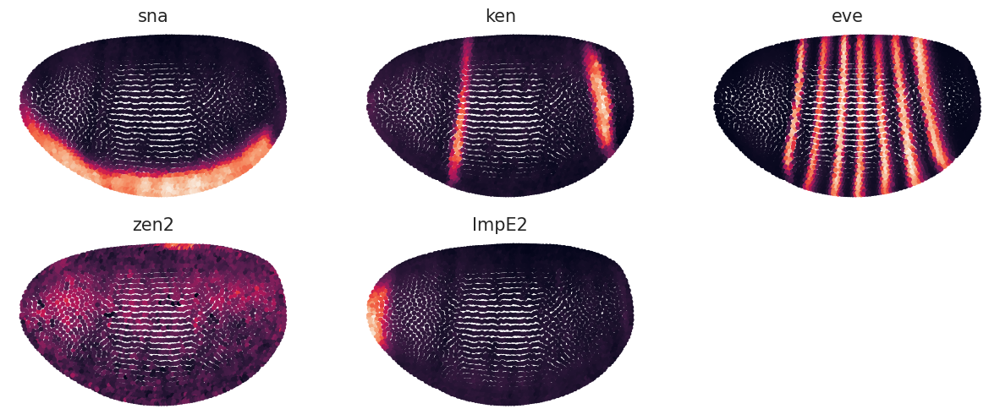

<Figure size 432x288 with 0 Axes>

In [3]:
# test
novosparc.pl.embedding(atlas, pl_genes)

In [4]:
expmtrx_truth = atlas.X

# # min-max normalization
# expmtrx_truth_normed = (expmtrx_truth - np.min(expmtrx_truth))/ (np.max(expmtrx_truth) - np.min(expmtrx_truth))

In [5]:
# zscore
expmtrx_truth_normed = zscore(expmtrx_truth)
expmtrx_truth_normed.shape

(3039, 84)

 ## Expression Matrix <a class="anchor" id="expression_matrix"></a>
 ### basic reconstruction <a class="anchor" id="basic_reconstruction"></a>

In [6]:
# calculate cost matrix
# params for smooth cost
num_neighbors_s = num_neighbors_t = 5

# params for linear cost
markers = list(set(atlas_genes).intersection(gene_names))
atlas_matrix = atlas.to_df()[markers].values
markers_idx = pd.DataFrame({'markers_idx': np.arange(num_genes)}, index=gene_names)
markers_to_use = np.concatenate(markers_idx.loc[markers].values)

# construct tissue object
tissue = novosparc.cm.Tissue(dataset=dataset, locations=locations_apriori)


tissue.setup_reconstruction(atlas_matrix=atlas_matrix,
                            markers_to_use=markers_to_use,
                            num_neighbors_s=num_neighbors_s,
                            num_neighbors_t=num_neighbors_t)

# dge_rep = None
tissue.setup_smooth_costs(dge_rep=dge_rep, num_neighbors_s=num_neighbors_s, num_neighbors_t=num_neighbors_t)

# compute optimal transport of cells to locations
alpha_linear = 0.8
epsilon = 5e-3
# tissue.dge = sparse.csr_matrix(tissue.dge)
tissue.reconstruct(alpha_linear=alpha_linear, epsilon=epsilon)

# reconstructed expression of individual genes
sdge = tissue.sdge
dataset_reconst = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
dataset_reconst.obsm['spatial'] = locations_apriori

Setting up for reconstruction ... done ( 3.62 seconds )
Setting up for reconstruction ... done ( 3.67 seconds )
Reconstructing spatial information with 84 markers: 1000 cells and 3039 locations ... 
Trying with epsilon: 5.00e-03
Trying with epsilon: 5.00e-03


/tmp/ipykernel_29848/2636297891.py:31: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  dataset_reconst = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [7]:
# plt.hist(tissue.gw)

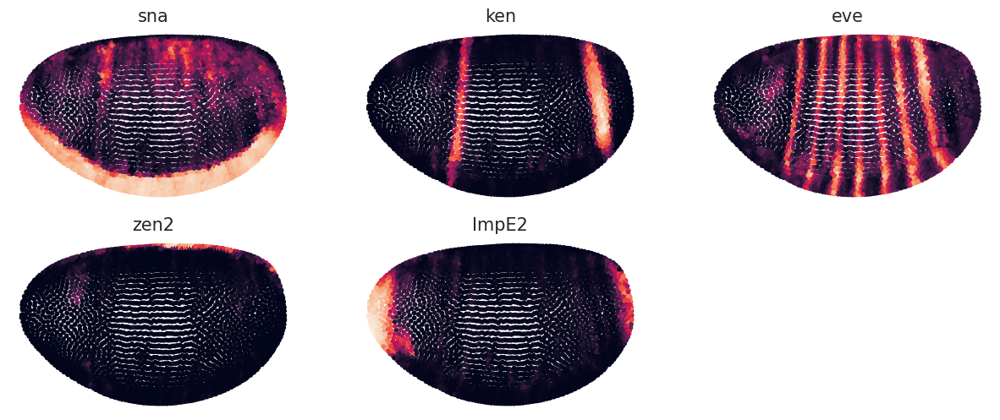

<Figure size 432x288 with 0 Axes>

In [8]:
# test
novosparc.pl.embedding(dataset_reconst, pl_genes)

In [9]:
subset_cols = []
for i, gene in enumerate(atlas_genes):
    if gene in dataset_reconst.var_names:
        subset_cols.append(np.asarray(dataset_reconst[:, gene].X).reshape(-1, 1))
exprmtrx_simplerecon = np.concatenate(subset_cols, axis=1)

In [10]:
# # min-max normalization
# exprmtrx_simplerecon_normed = (exprmtrx_simplerecon - np.min(exprmtrx_simplerecon))/ (np.max(exprmtrx_simplerecon) - np.min(exprmtrx_simplerecon))

In [11]:
# zscore
exprmtrx_simplerecon_normed = zscore(exprmtrx_simplerecon)
exprmtrx_simplerecon_normed.shape

(3039, 84)

In [12]:
type(atlas_genes)

list

## Expression Matrix
### basic cleaning <a class="anchor" id="basic_cleaning"></a>

ToDo: I should think about how to do this in a function so I can do this for multiple settings. Outputting a list of expression matrixes, which I then can use for all the calculations and stuff


In [13]:
# construct tissue object
tissue_postcleaned = novosparc.cm.Tissue(dataset=dataset, locations=locations_apriori)

# alternative 1: setup both assumptions
tissue_postcleaned.setup_reconstruction(atlas_matrix=atlas_matrix,
                            markers_to_use=markers_to_use,
                            num_neighbors_s=num_neighbors_s,
                            num_neighbors_t=num_neighbors_t)

tissue_postcleaned.setup_smooth_costs(dge_rep=dge_rep, num_neighbors_s=num_neighbors_s, num_neighbors_t=num_neighbors_t)

# compute optimal transport of cells to locations
alpha_linear = 0.8
epsilon = 5e-3
# tissue.dge = sparse.csr_matrix(tissue.dge)
tissue_postcleaned.reconstruct(alpha_linear=alpha_linear, epsilon=epsilon)

# reconstructed expression of individual genes
sdge = tissue_postcleaned.sdge

dataset_reconst_postcleaned = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
dataset_reconst_postcleaned.obsm['spatial'] = locations_apriori
# GMM
tissue_postcleaned.cleaning_expression_data(dataset_reconst_postcleaned,tissue_postcleaned.sdge.T,normalization='zscore', selected_genes=atlas_genes)

# reconstructed expression of individual genes
sdge_postcleaned = tissue_postcleaned.cleaned_dge
dataset_reconst_postcleaned = sc.AnnData(pd.DataFrame(sdge_postcleaned, columns=gene_names))
dataset_reconst_postcleaned.obsm['spatial'] = locations_apriori

Setting up for reconstruction ... done ( 3.58 seconds )
Setting up for reconstruction ... done ( 3.56 seconds )
Reconstructing spatial information with 84 markers: 1000 cells and 3039 locations ... 
Trying with epsilon: 5.00e-03
Trying with epsilon: 5.00e-03


/tmp/ipykernel_29848/2647430811.py:21: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  dataset_reconst_postcleaned = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/sklearn/mixture/_base.py:286: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/sklearn/mixture/_base.py:286: ConvergenceWarning: Initialization 1 did not converg

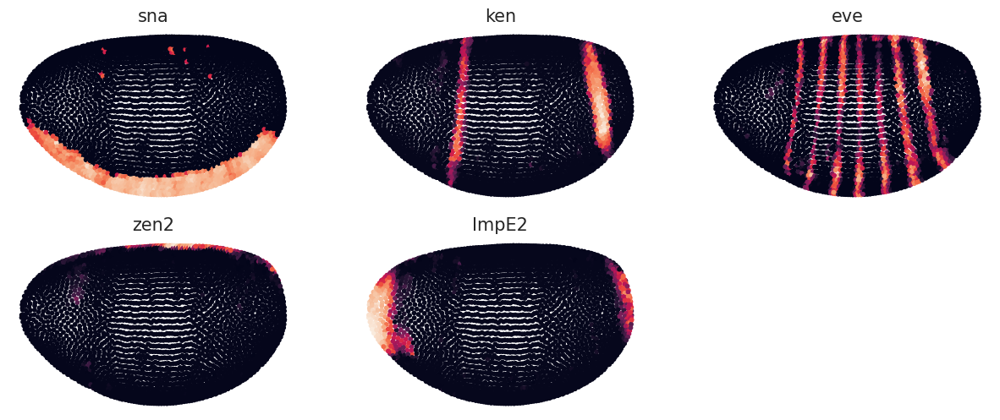

<Figure size 432x288 with 0 Axes>

In [14]:
# test
novosparc.pl.embedding(dataset_reconst_postcleaned, pl_genes)

In [15]:
subset_cols = []
for i, gene in enumerate(atlas_genes):
    if gene in dataset_reconst_postcleaned.var_names:
        subset_cols.append(np.asarray(dataset_reconst_postcleaned[:, gene].X).reshape(-1, 1))
exprmtrx_recon_defaultGMM = np.concatenate(subset_cols, axis=1)

In [16]:
# min-max normalization
# exprmtrx_recon_defaultGMM_normed = (exprmtrx_recon_defaultGMM - np.min(exprmtrx_recon_defaultGMM))/ (np.max(exprmtrx_recon_defaultGMM) - np.min(exprmtrx_recon_defaultGMM))

In [17]:
# zscore norm
# should be already normalized
exprmtrx_recon_defaultGMM_normed = exprmtrx_recon_defaultGMM

In [18]:

exprmtrx_recon_defaultGMM_normed.shape

(3039, 84)

## Comparing results <a class="anchor" id="comparing_results"></a>
ToDo: also make this a function you can loop though just plotting the results in the end

### Correlation Measurement Functions <a class="anchor" id="corre_functions"></a>

In [19]:
def mse(actual, pred):
    actual, pred = np.array(actual), np.array(pred)
    return np.square(np.subtract(actual,pred)).mean()

def rmse(actual, pred):
    actual, pred = np.array(actual), np.array(pred)
    return np.sqrt(np.square(np.subtract(actual,pred)).mean())

def mean_pearson(actual, pred):
    r_per_gene = []
    for i in range(actual.shape[1]):
        r_score,p_value = pearsonr(actual[:,i],
                 pred[:,i])
        r_per_gene.append(r_score) # assumption all p-values are acceptable ToDo: make version with filtering for p-values
    return r_per_gene, np.mean(r_per_gene)

def mean_spearman(actual, pred):
    r_per_gene = []
    for i in range(actual.shape[1]):
        r_score,p_value = spearmanr(actual[:,i],
                 pred[:,i])
        r_per_gene.append(r_score) # assumption all p-values are acceptable ToDo: make version with filtering for p-values
    return r_per_gene, np.mean(r_per_gene)

def box_swarm_label(plot_df, score_name, single_dfs=None):
    ## plot_df must contain columns "gene", "r score (pearson)", and "method" (being the  reconstruction/cleaning)

    figure(figsize=(11, 12), dpi=80)

    sns.boxplot(x="method", y=score_name, data=plot_df, whis=np.inf)
    sns.swarmplot(x="method", y=score_name, data=plot_df,
                  palette=["crimson","indigo"])

    if single_dfs:
        for counter, single_df in enumerate(single_dfs):

            for x,y, label in zip([counter]*len(plot_df), single_df[score_name], single_df["gene"]):
                plt.text(x = x + 0.1, y = y,
                         s = label,
                         rotation= 45)
    plt.show()

def filter_matrix_for_genes(dataframe, gene_list):
    filtered_df = dataframe[dataframe.gene.isin(gene_list)]
    return filtered_df

# def invest_plot_for_correlations(truth_df, list_of_expression_mtrx, list_of_special_genes, list_of_score_cutoffs)
# ToDo

### Pearson Correlation <a class="anchor" id="pearson"></a>

In [20]:
method_recon = ["normal reconstruct"] * len(atlas_genes)
r_values_recon, mean_corre_recon = mean_pearson(expmtrx_truth_normed, exprmtrx_simplerecon_normed)
pearson_corre_reconstruction = pd.DataFrame(list(zip(atlas_genes,r_values_recon, method_recon)),
                                    columns=["gene","r score (pearson)","method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
r_values_clean, mean_corre_clean = mean_pearson(expmtrx_truth_normed, exprmtrx_recon_defaultGMM_normed)
pearson_corre_cleaned = pd.DataFrame(list(zip(atlas_genes,r_values_clean, method_clean)),
                                    columns=["gene","r score (pearson)","method"])

pearson_corre_plt = pd.concat([pearson_corre_reconstruction,pearson_corre_cleaned])

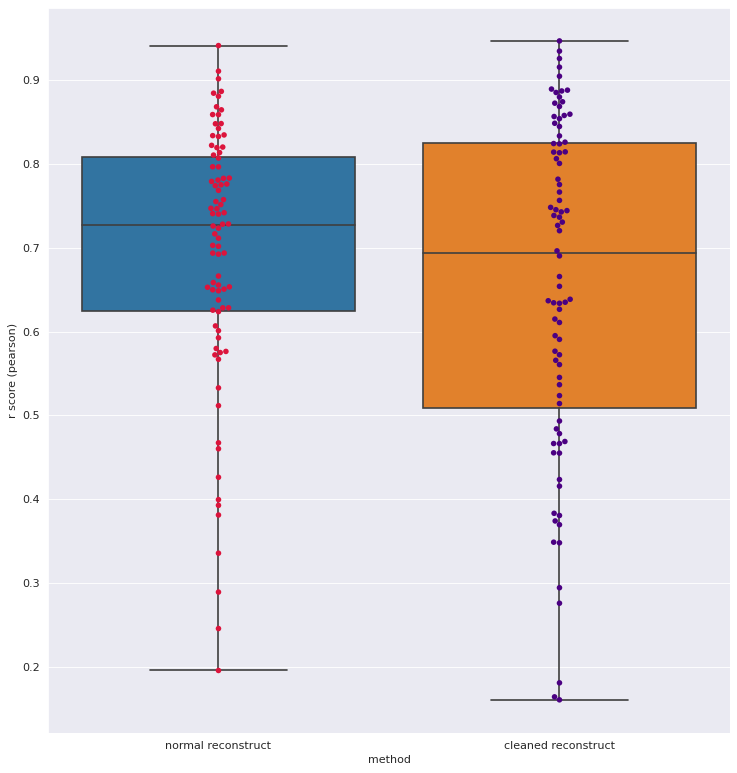

In [21]:
box_swarm_label(pearson_corre_plt,"r score (pearson)")

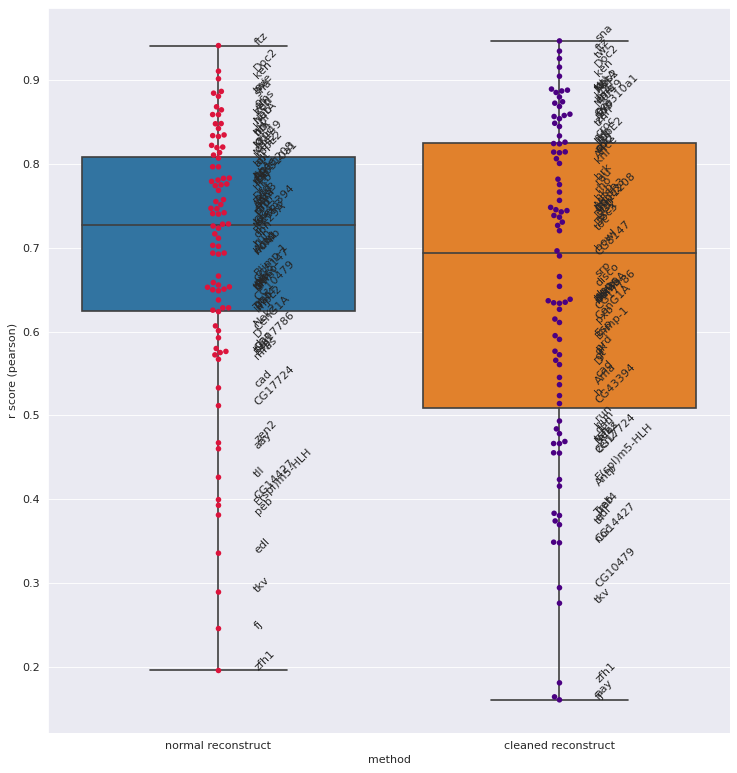

In [22]:
box_swarm_label(pearson_corre_plt,"r score (pearson)",
                [pearson_corre_reconstruction,pearson_corre_cleaned])

<Figure size 720x360 with 0 Axes>

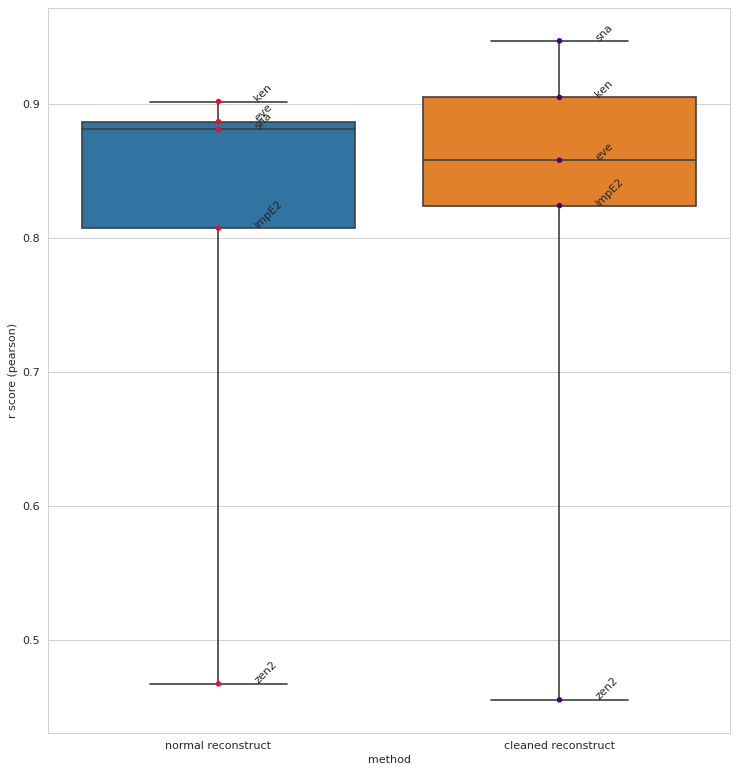

ground truth


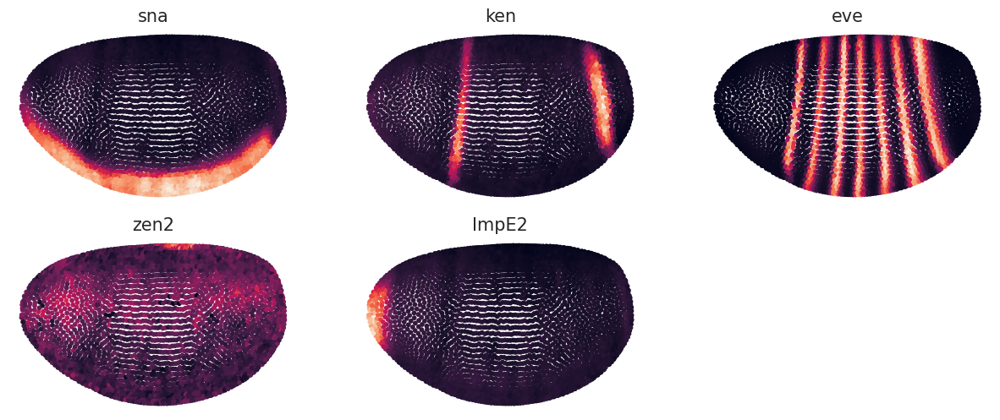

reconstruction


<Figure size 432x288 with 0 Axes>

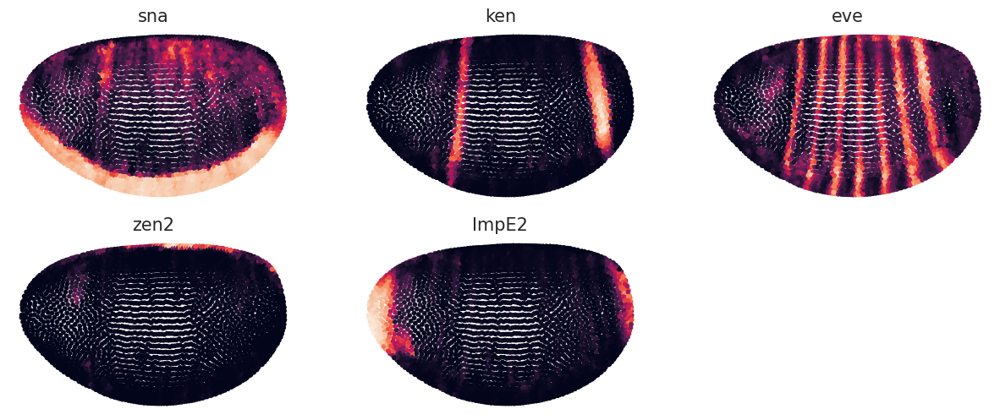

cleaning


<Figure size 432x288 with 0 Axes>

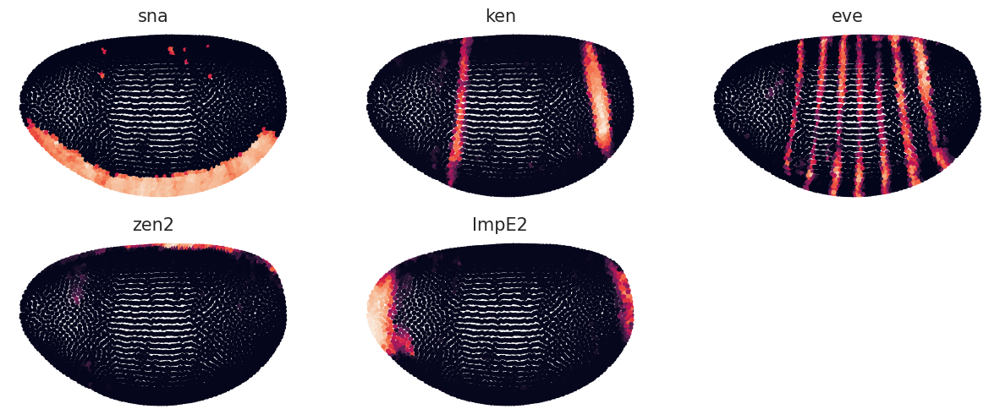

<Figure size 432x288 with 0 Axes>

In [38]:
from matplotlib.gridspec import GridSpec
# plotting genes of interest
invest_genes1 = pl_genes = ['sna', 'ken', 'eve','zen2','ImpE2']
# high scoring genes
high_score_genes = list(pearson_corre_reconstruction[pearson_corre_reconstruction["r score (pearson)"] >=0.7].gene)
# low scoring genes
low_score_genes = list(pearson_corre_reconstruction[pearson_corre_reconstruction["r score (pearson)"] <=0.5].gene)

# I think this should also be loopable
fig = plt.figure(figsize=(10, 5))
gs = GridSpec(nrows=2, ncols=2)
# pearson_invest_genes1

box_swarm_label(filter_matrix_for_genes(pearson_corre_plt,invest_genes1),
                "r score (pearson)",
                [filter_matrix_for_genes(pearson_corre_reconstruction,invest_genes1),
                filter_matrix_for_genes(pearson_corre_cleaned,invest_genes1)])
print("ground truth")
novosparc.pl.embedding(atlas, invest_genes1)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, invest_genes1)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, invest_genes1)

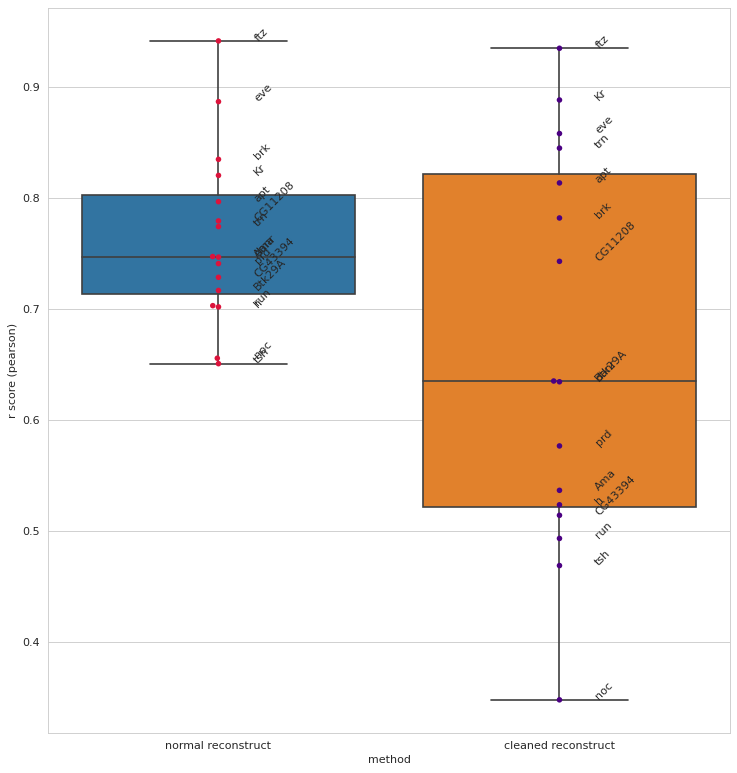

ground truth


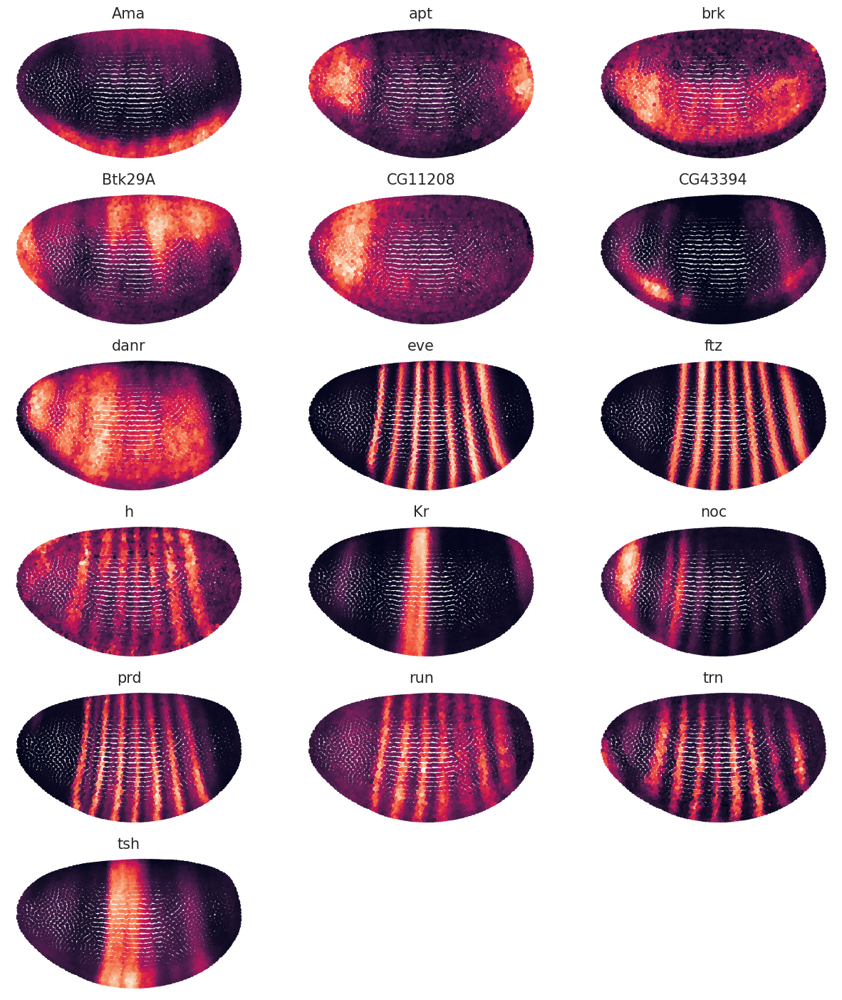

reconstruction


<Figure size 432x288 with 0 Axes>

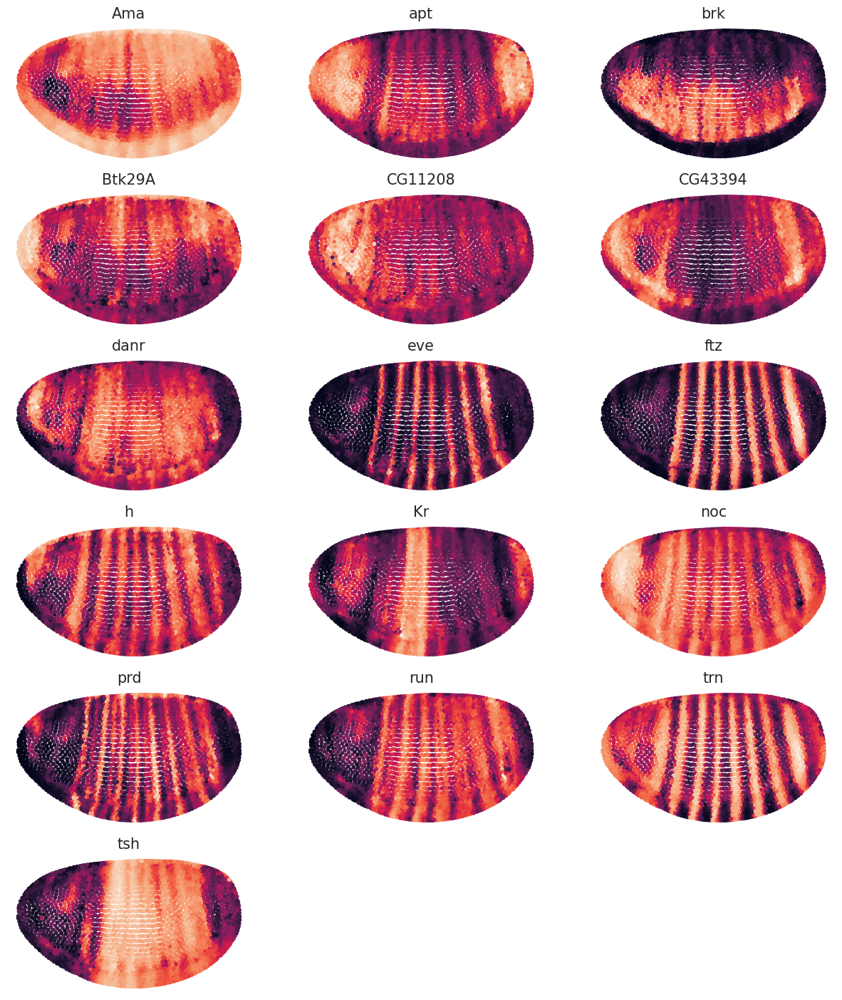

cleaning


<Figure size 432x288 with 0 Axes>

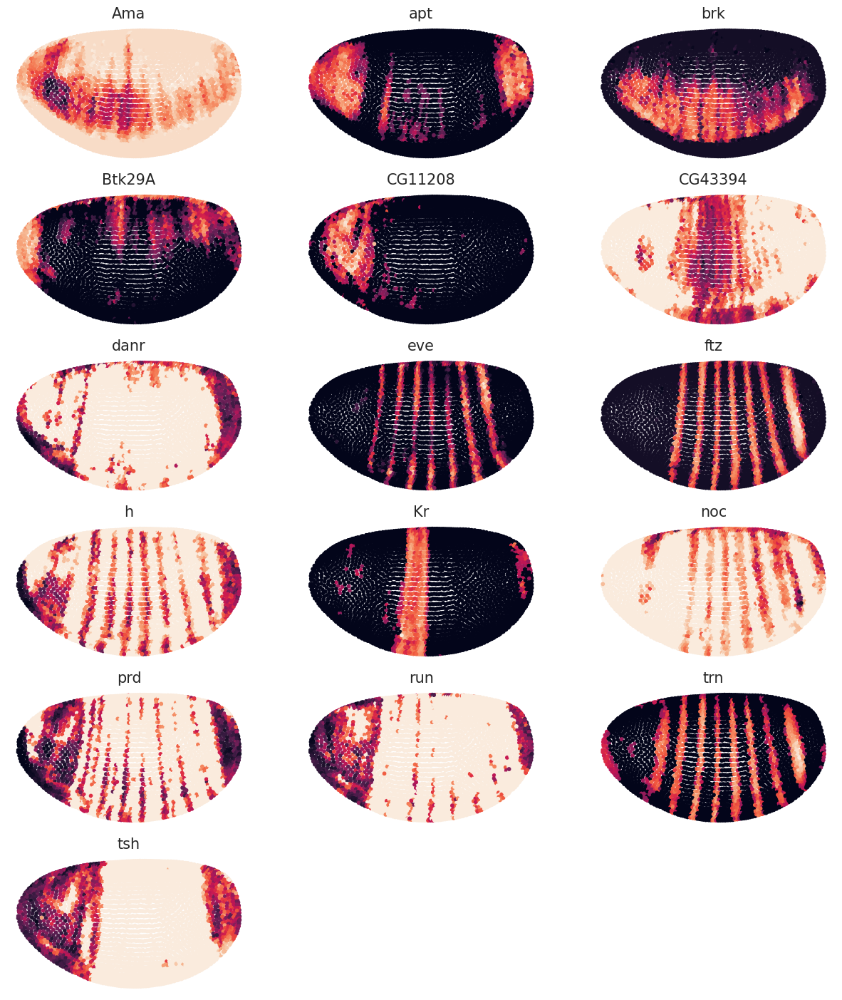

<Figure size 432x288 with 0 Axes>

In [41]:
# high scoring genes
box_swarm_label(filter_matrix_for_genes(pearson_corre_plt,high_score_genes),
                "r score (pearson)",
                [filter_matrix_for_genes(pearson_corre_reconstruction,high_score_genes),
                filter_matrix_for_genes(pearson_corre_cleaned,high_score_genes)])
print("ground truth")
novosparc.pl.embedding(atlas, high_score_genes)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, high_score_genes)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, high_score_genes)

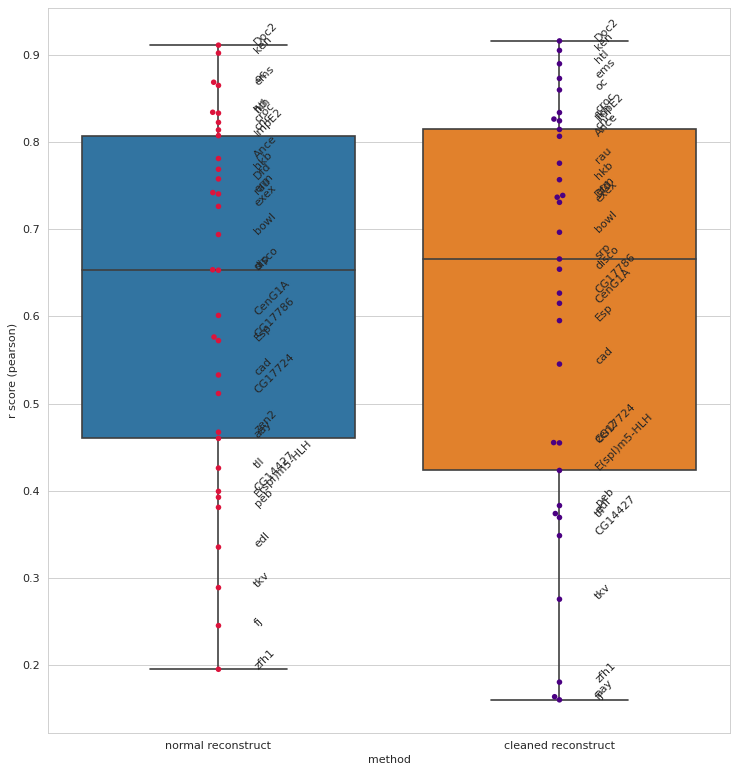

ground truth


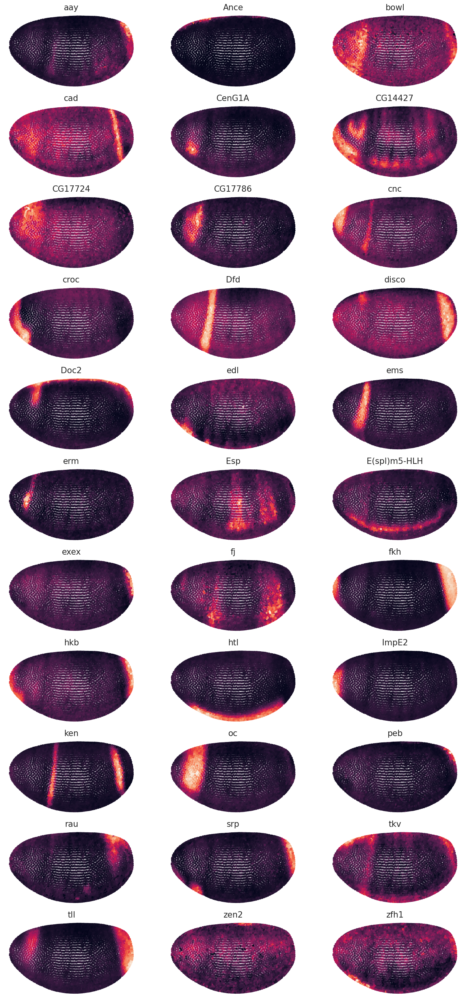

reconstruction


<Figure size 432x288 with 0 Axes>

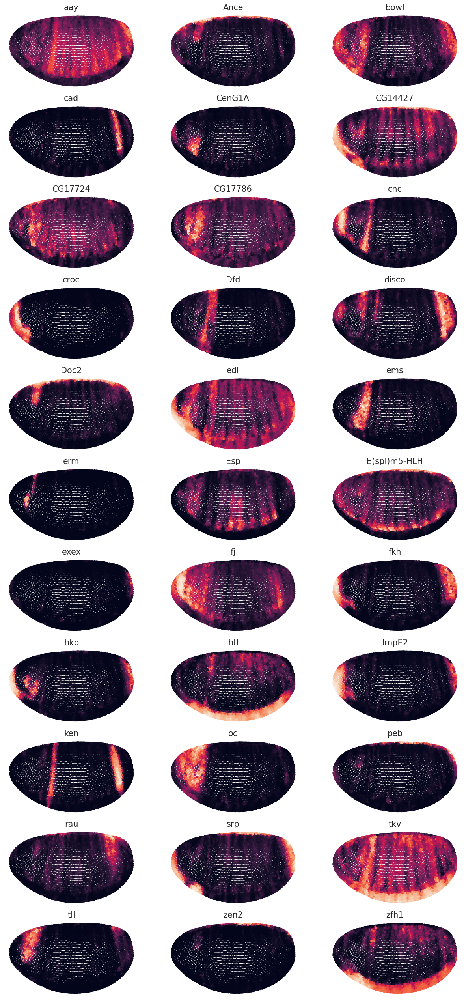

cleaning


<Figure size 432x288 with 0 Axes>

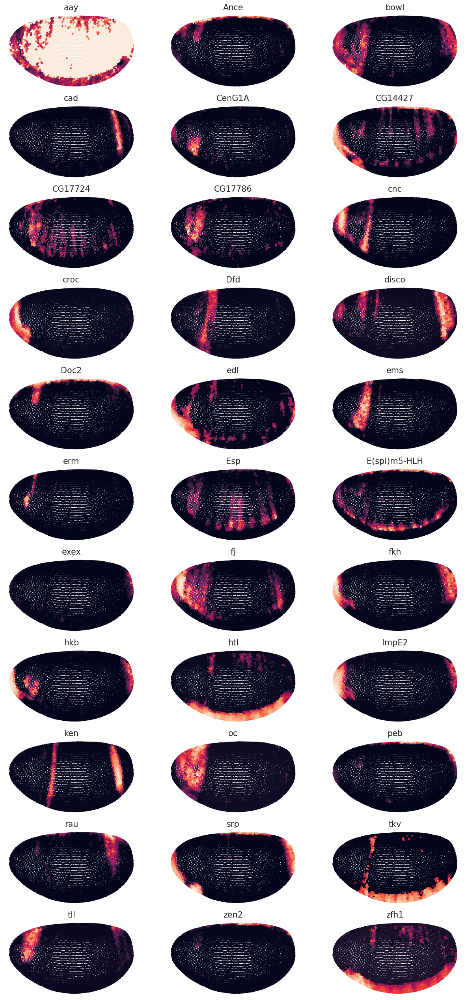

<Figure size 432x288 with 0 Axes>

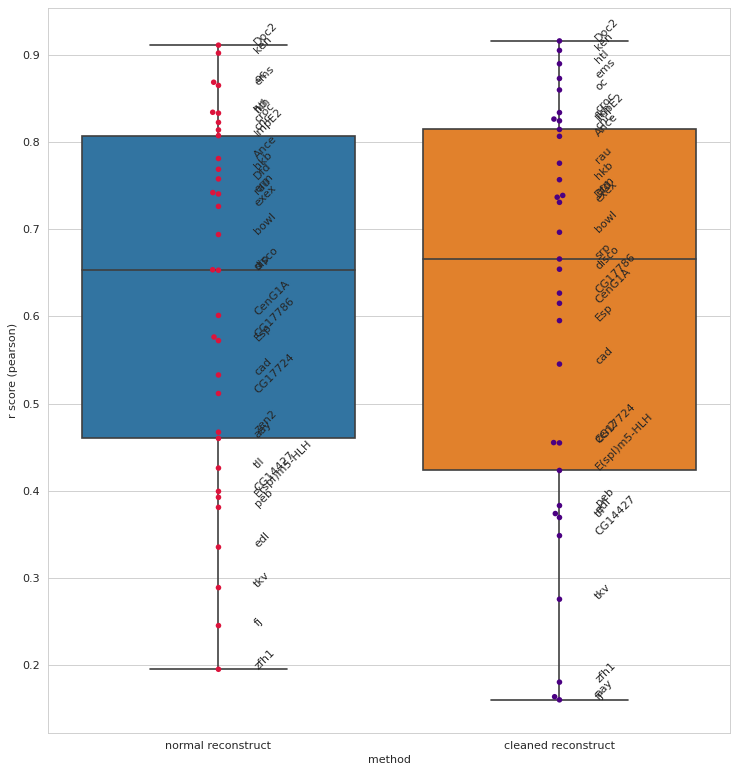

ground truth


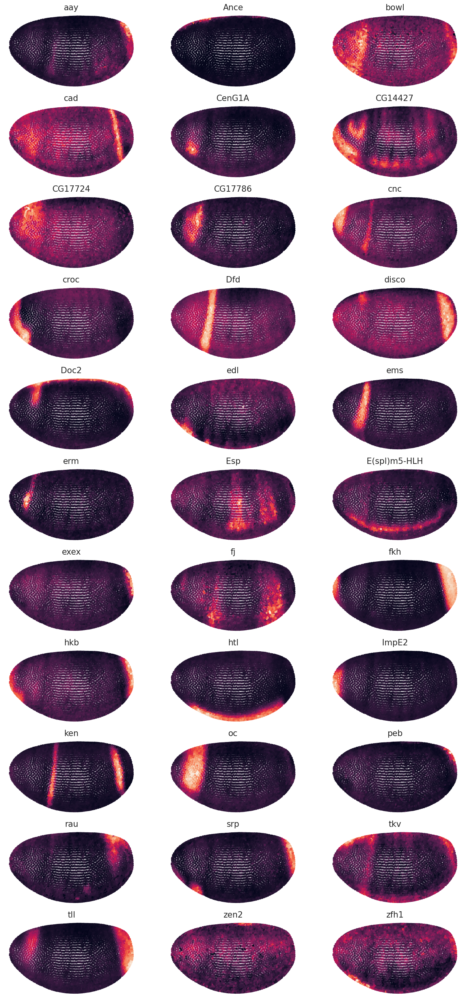

reconstruction


<Figure size 432x288 with 0 Axes>

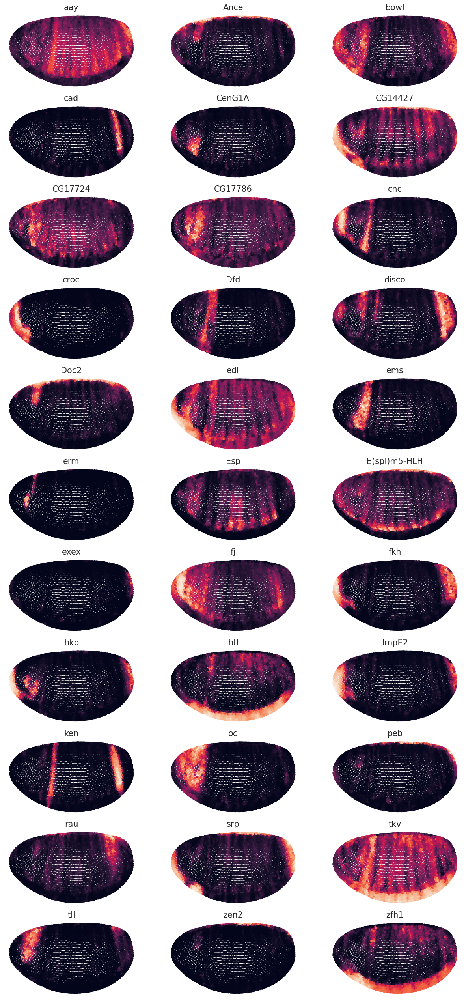

cleaning


<Figure size 432x288 with 0 Axes>

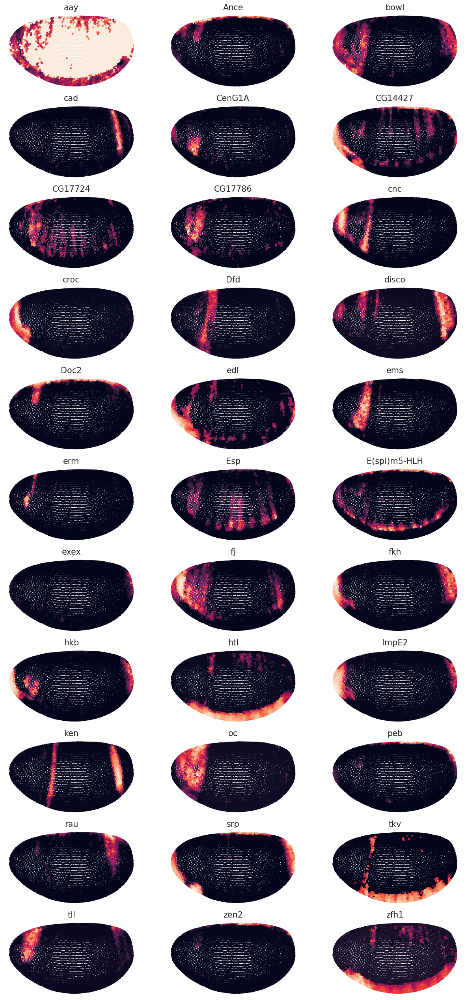

<Figure size 432x288 with 0 Axes>

In [43]:
# low scoring genes
box_swarm_label(filter_matrix_for_genes(pearson_corre_plt,low_score_genes),
                "r score (pearson)",
                [filter_matrix_for_genes(pearson_corre_reconstruction,low_score_genes),
                filter_matrix_for_genes(pearson_corre_cleaned,low_score_genes)])

print("ground truth")
novosparc.pl.embedding(atlas, low_score_genes)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, low_score_genes)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, low_score_genes)

### Spearman correlation

Following Artürs advice I will use Spearman over Pearson as it appears to be better for gene expression stuff. His explanaiton: "the reason for that is the continuity assumption of euclidean plus the high dimensionality of the gene panel"

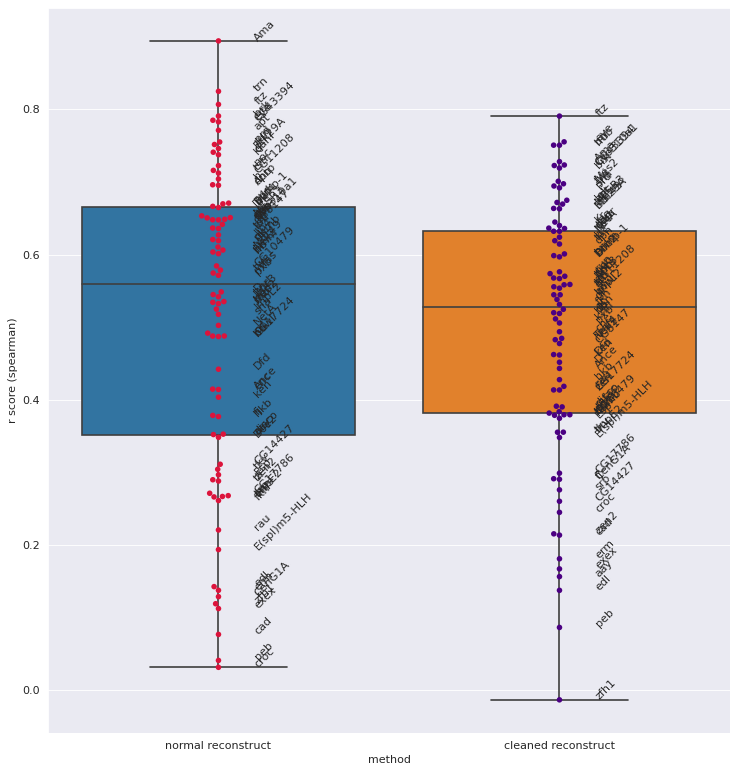

In [26]:
method_recon = ["normal reconstruct"] * len(atlas_genes)
r_values_recon, mean_corre_recon = mean_spearman(expmtrx_truth_normed, exprmtrx_simplerecon_normed)
spearman_corre_reconstruction = pd.DataFrame(list(zip(atlas_genes,r_values_recon, method_recon)),
                                    columns=["gene","r score (spearman)","method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
r_values_clean, mean_corre_clean = mean_spearman(expmtrx_truth_normed, exprmtrx_recon_defaultGMM_normed)
spearman_corre_cleaned = pd.DataFrame(list(zip(atlas_genes,r_values_clean, method_clean)),
                                    columns=["gene","r score (spearman)","method"])

spearman_corre_plt = pd.concat([spearman_corre_reconstruction,spearman_corre_cleaned])
box_swarm_label(spearman_corre_plt,
                "r score (spearman)",
                [spearman_corre_reconstruction,spearman_corre_cleaned])

In [48]:
spearman_corre_plt.loc[spearman_corre_plt['gene'] == "apt"]

,gene,r score (spearman),method
4,apt,0.771144,normal reconstruct
4,apt,0.671755,cleaned reconstruct


In [45]:

# plotting genes of interest
invest_genes1 = pl_genes = ['sna', 'ken', 'eve', 'zen2', 'ImpE2']
# high scoring genes
high_score_genes = list(spearman_corre_reconstruction[spearman_corre_reconstruction["r score (spearman)"] >= 0.7].gene)
# low scoring genes
low_score_genes = list(spearman_corre_reconstruction[spearman_corre_reconstruction["r score (spearman)"] <= 0.5].gene)
high_score_genes

['Ama',
 'apt',
 'brk',
 'Btk29A',
 'CG11208',
 'CG43394',
 'danr',
 'eve',
 'ftz',
 'h',
 'Kr',
 'noc',
 'prd',
 'run',
 'trn',
 'tsh']

paper plotting genes


<Figure size 720x360 with 0 Axes>

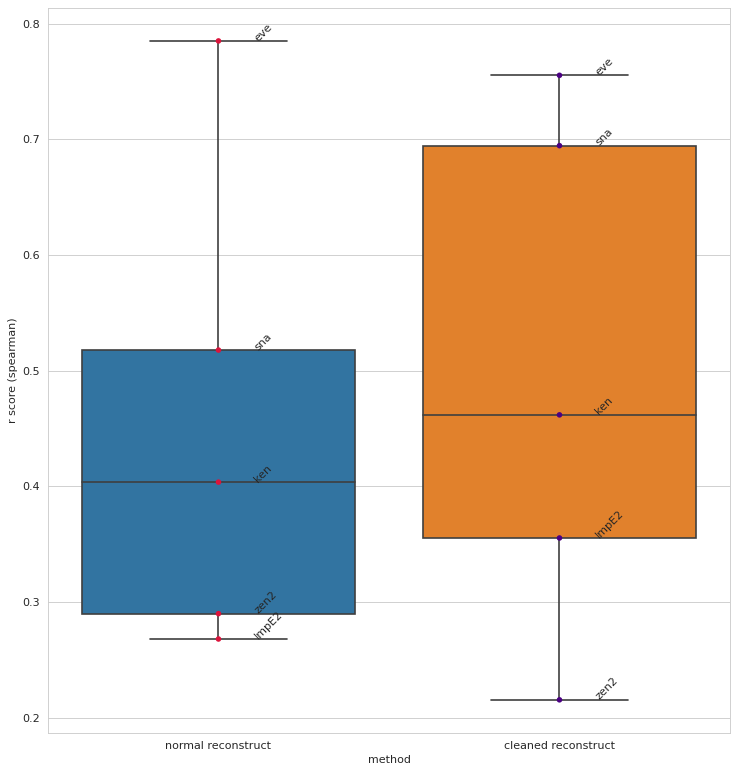

ground truth


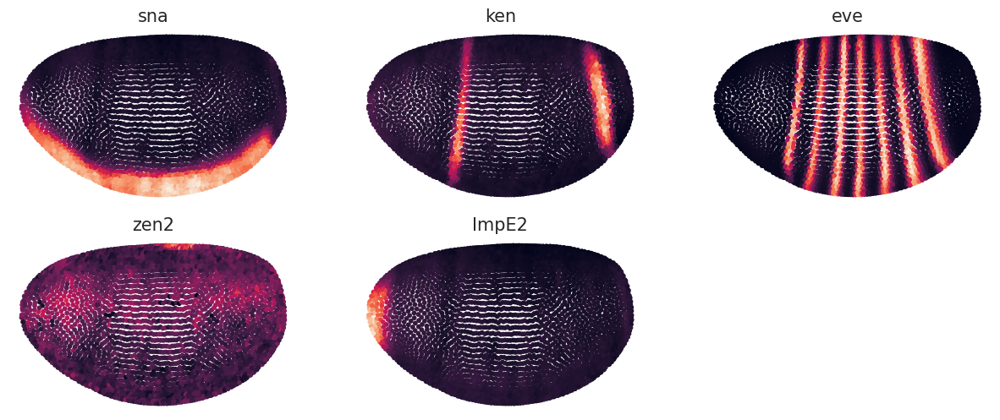

reconstruction


<Figure size 432x288 with 0 Axes>

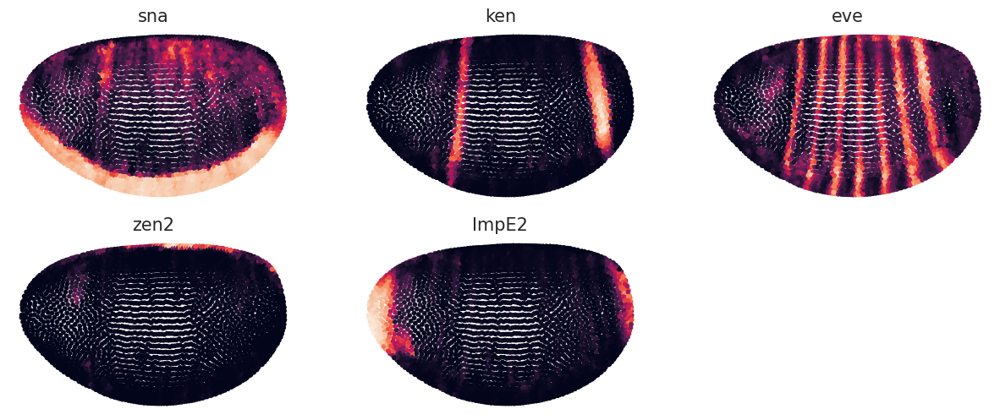

cleaning


<Figure size 432x288 with 0 Axes>

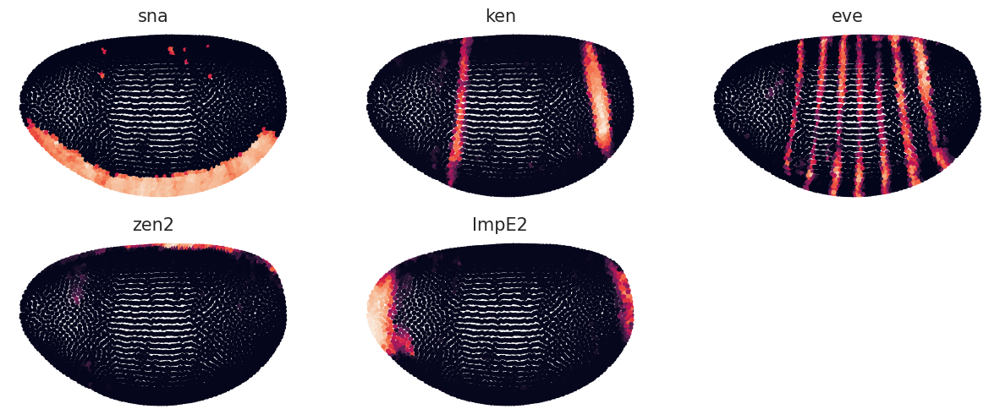

high scoring genes


<Figure size 432x288 with 0 Axes>

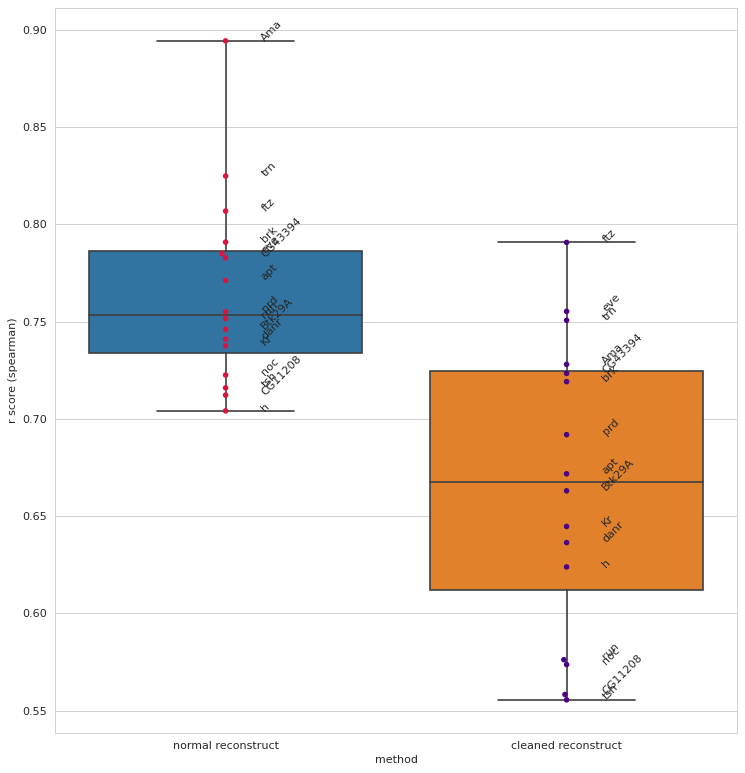

ground truth


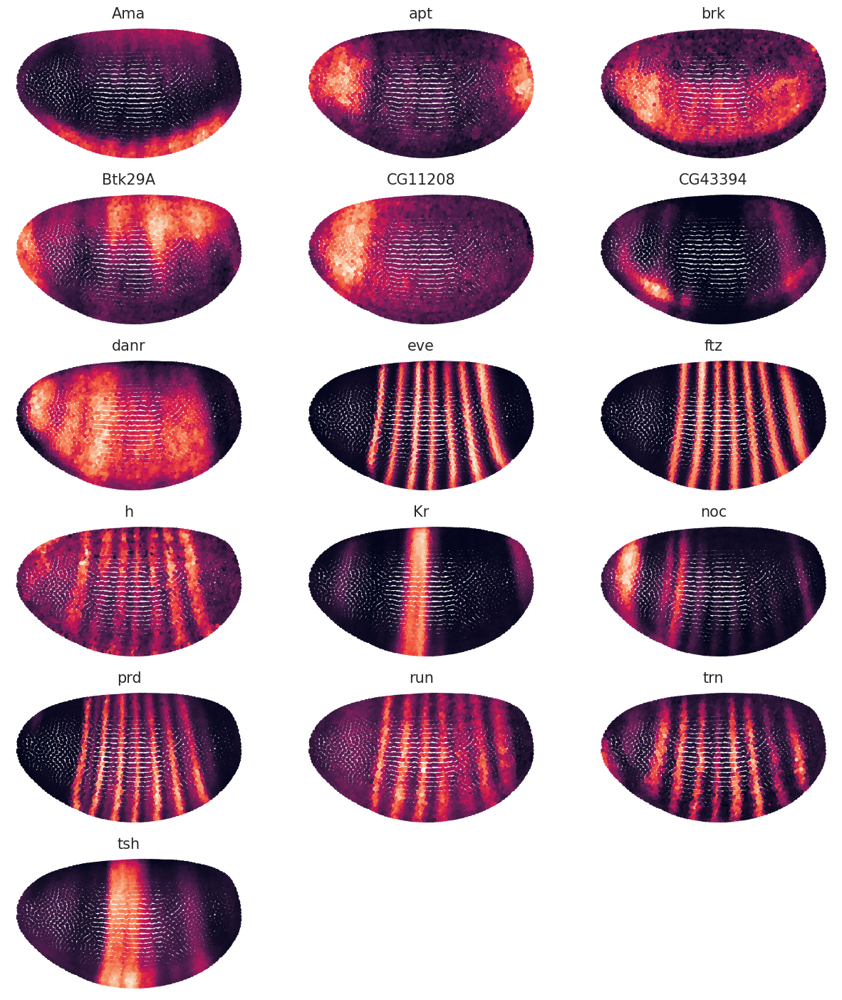

reconstruction


<Figure size 432x288 with 0 Axes>

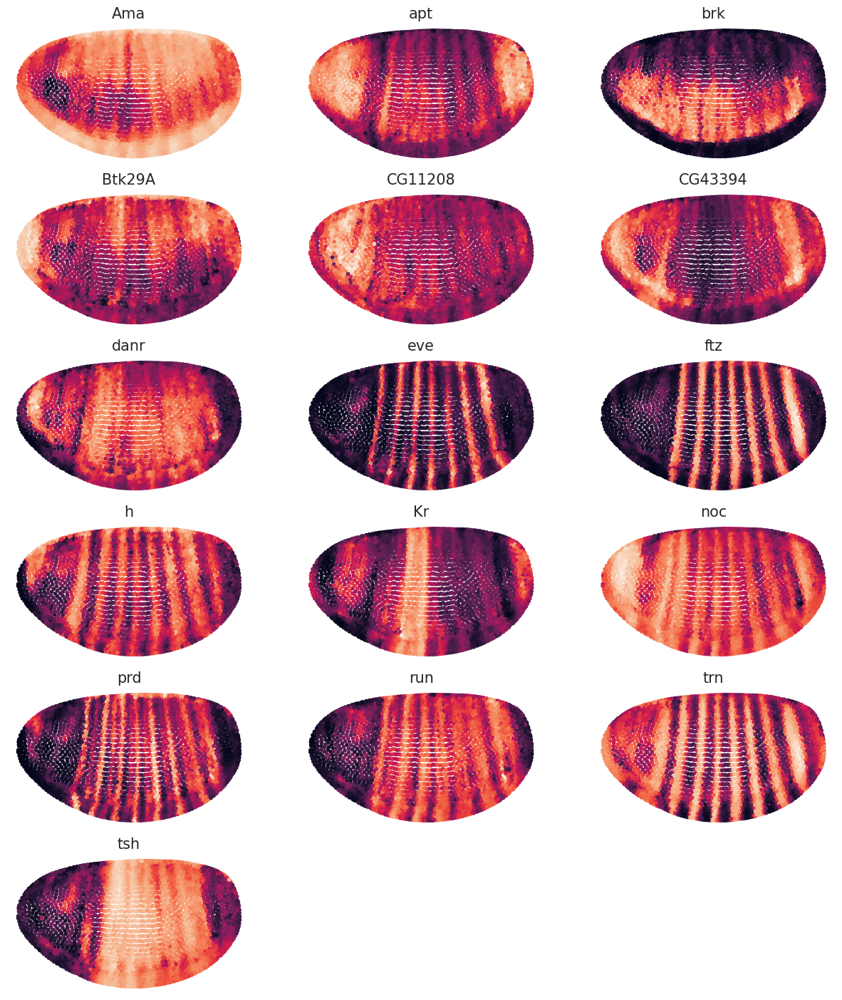

cleaning


<Figure size 432x288 with 0 Axes>

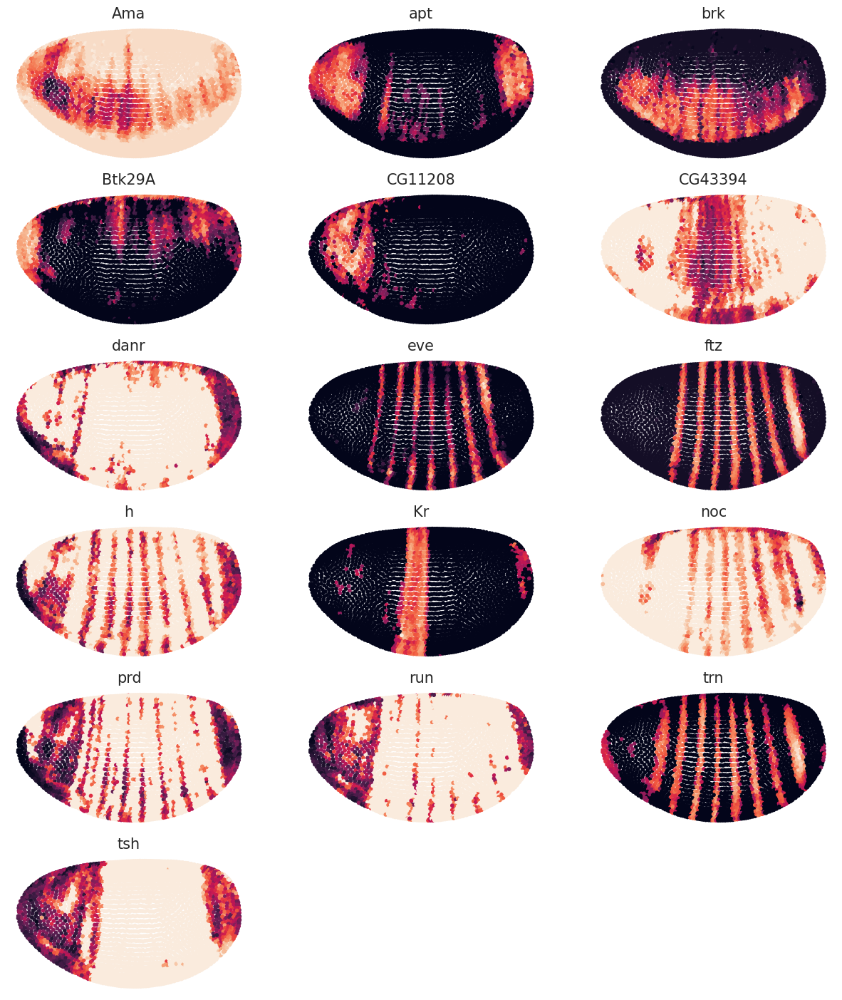

low scoring genes


<Figure size 432x288 with 0 Axes>

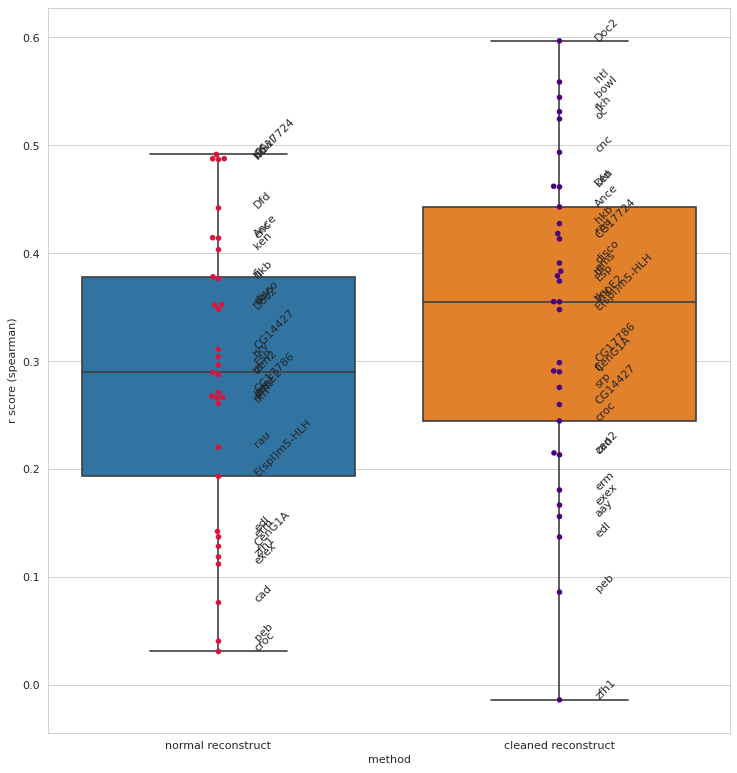

ground truth


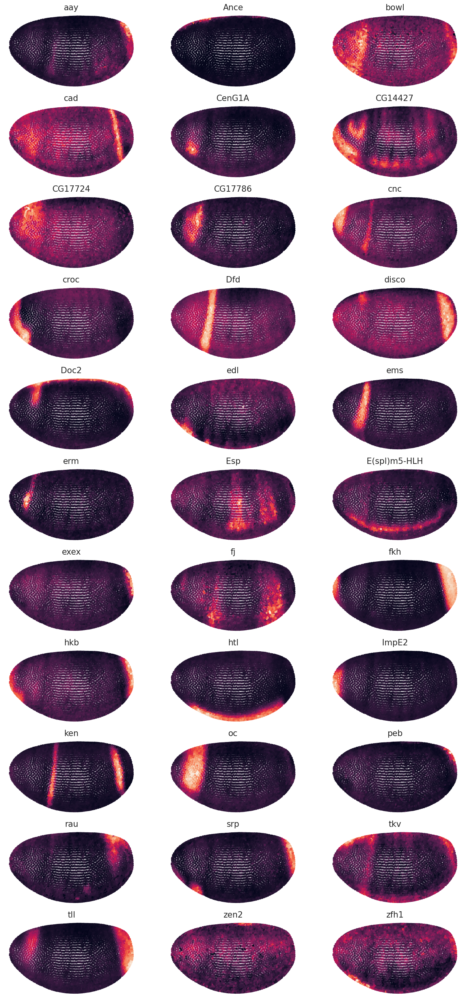

reconstruction


<Figure size 432x288 with 0 Axes>

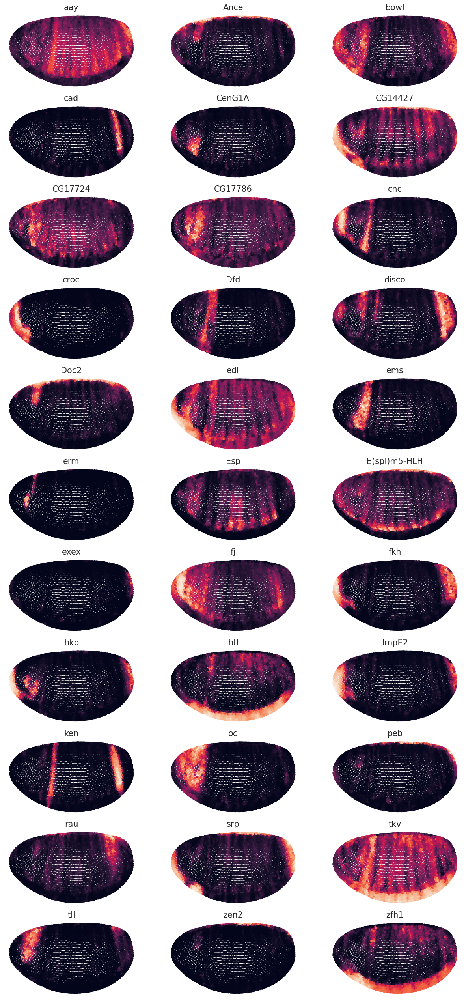

cleaning


<Figure size 432x288 with 0 Axes>

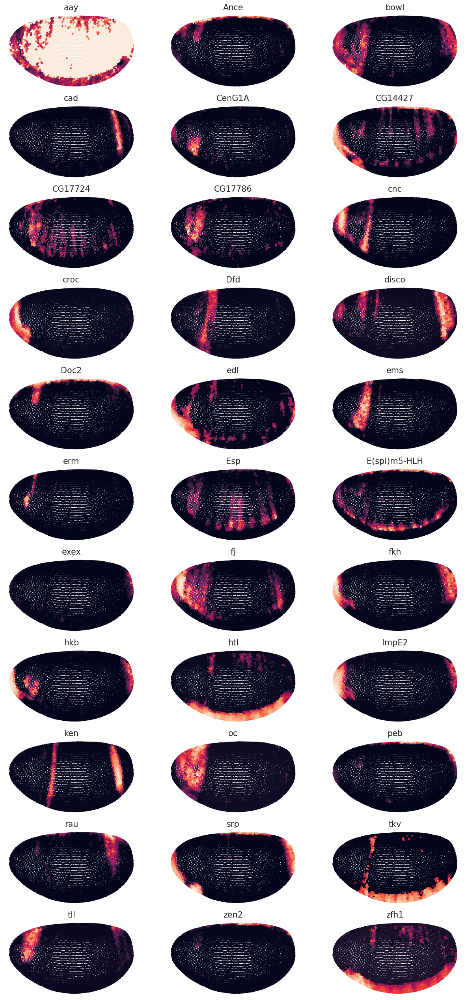

<Figure size 432x288 with 0 Axes>

In [40]:

# I think this should also be loopable
fig = plt.figure(figsize=(10, 5))
gs = GridSpec(nrows=2, ncols=2)
# pearson_invest_genes1
print("paper plotting genes")
box_swarm_label(filter_matrix_for_genes(spearman_corre_plt, invest_genes1),
                "r score (spearman)",
                [filter_matrix_for_genes(spearman_corre_reconstruction, invest_genes1),
                 filter_matrix_for_genes(spearman_corre_cleaned, invest_genes1)])
print("ground truth")
novosparc.pl.embedding(atlas, invest_genes1)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, invest_genes1)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, invest_genes1)

# high scoring genes
print("high scoring genes")
box_swarm_label(filter_matrix_for_genes(spearman_corre_plt, high_score_genes),
                "r score (spearman)",
                [filter_matrix_for_genes(spearman_corre_reconstruction, high_score_genes),
                 filter_matrix_for_genes(spearman_corre_cleaned, high_score_genes)])
print("ground truth")
novosparc.pl.embedding(atlas, high_score_genes)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, high_score_genes)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, high_score_genes)

# low scoring genes
print("low scoring genes")
box_swarm_label(filter_matrix_for_genes(spearman_corre_plt, low_score_genes),
                "r score (spearman)",
                [filter_matrix_for_genes(spearman_corre_reconstruction, low_score_genes),
                 filter_matrix_for_genes(spearman_corre_cleaned, low_score_genes)])

print("ground truth")
novosparc.pl.embedding(atlas, low_score_genes)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, low_score_genes)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, low_score_genes)

### Cosine Similarity <a class="anchor" id="cosine"></a>

In [29]:
len(r_values_recon)

84

In [30]:
method_recon = ["normal reconstruct"] * len(atlas_genes)

cosin_sim_values_recon = sklearn.metrics.pairwise.cosine_similarity(expmtrx_truth_normed.T, exprmtrx_simplerecon_normed.T)
cosin_sim_values_recon

array([[ 0.4600472 , -0.06376915, -0.15820737, ..., -0.15185864,
        -0.08031424,  0.04636334],
       [-0.6030621 ,  0.7467302 ,  0.02578755, ...,  0.12010889,
         0.148482  ,  0.74325794],
       [-0.12867501,  0.22771515,  0.7809285 , ...,  0.60931134,
         0.4209033 , -0.16476426],
       ...,
       [-0.14240776,  0.3221874 ,  0.6773234 , ...,  0.85916376,
         0.813765  , -0.24379805],
       [ 0.01619984, -0.01292207,  0.26756164, ...,  0.35968074,
         0.46717772, -0.23295078],
       [-0.1357147 ,  0.08776291,  0.13052055, ...,  0.04298637,
         0.04576613,  0.19529246]], dtype=float32)

In [31]:

r_values_recon, mean_corre_recon = mean_pearson(expmtrx_truth_normed, exprmtrx_simplerecon_normed)
corre_reconstruction = pd.DataFrame(list(zip(atlas_genes,r_values_recon, method_recon)),
                                    columns=["gene","r score (pearson)","method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
r_values_clean, mean_corre_clean = mean_pearson(expmtrx_truth_normed, exprmtrx_recon_defaultGMM_normed)
corre_cleaned = pd.DataFrame(list(zip(atlas_genes,r_values_clean, method_clean)),
                                    columns=["gene","r score (pearson)","method"])

pearson_corre_plt = pd.concat([corre_reconstruction,corre_cleaned])

### Structural Similarity <a class="anchor" id="struc_sim"></a>

In [32]:

r_values_recon, mean_corre_recon = mean_pearson(expmtrx_truth_normed, exprmtrx_simplerecon_normed)
corre_reconstruction = pd.DataFrame(list(zip(atlas_genes,r_values_recon, method_recon)),
                                    columns=["gene","r score (pearson)","method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
r_values_clean, mean_corre_clean = mean_pearson(expmtrx_truth_normed, exprmtrx_recon_defaultGMM_normed)
corre_cleaned = pd.DataFrame(list(zip(atlas_genes,r_values_clean, method_clean)),
                                    columns=["gene","r score (pearson)","method"])

pearson_corre_plt = pd.concat([corre_reconstruction,corre_cleaned])

## Diagnostic plots

In [49]:
# make here a diagnostic plot for evaluating the possible reasons for those weird correlation scores for genes like "ama", "noc" etc.

# expmtrx_truth_normed, exprmtrx_simplerecon_normed

# plt.boxplot(expmtrx_truth_normed.loc[expmtrx_truth_normed['gene'] == "apt"]
expmtrx_truth_normed

array([[-0.50827414, -0.38027003, -0.43668044, ..., -0.59378564,
        -0.58954924,  0.23967938],
       [-0.52713054, -0.4420873 , -0.35361272, ..., -0.62559587,
         0.29640096,  0.3454483 ],
       [-0.6477735 , -0.5869767 , -0.41837624, ..., -0.6661173 ,
         1.0988327 ,  1.0450904 ],
       ...,
       [-0.6294659 ,  1.3212422 , -0.57936454, ..., -0.6832969 ,
        -1.555915  ,  0.28846428],
       [ 0.10469359,  1.7304966 , -0.3228277 , ..., -0.48050305,
        -0.3502446 , -0.29282212],
       [-0.9739545 ,  0.55865663, -0.08643594, ...,  1.425059  ,
         0.35966712, -0.7091865 ]], dtype=float32)

### Plotting experiments

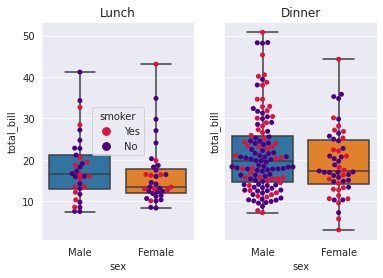

In [33]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

tips = sns.load_dataset("tips")

fig, axes = plt.subplots(ncols=2, sharex=True, sharey=True)

for ax, (n,grp) in zip(axes, tips.groupby("time")):
    sns.boxplot(x="sex", y="total_bill", data=grp, whis=np.inf, ax=ax)
    sns.swarmplot(x="sex", y="total_bill", hue="smoker", data=grp,
                  palette=["crimson","indigo"], ax=ax)
    ax.set_title(n)
axes[-1].get_legend().remove()
plt.show()

In [34]:
for x in range(10):
    print(x)
    if x > 3:
        break
else:
    print("a")

0
1
2
3
4
